# Supervised Learning
## Sentiment Analysis on Amazon.com Banned Book Reviews

## Install Dependencies 

In [1]:
#!pip install -r requirements.txt

In [7]:
#!python -m spacy download en_core_web_sm

In [2]:
#!pip install textblob cufflinks imblearn spacy pyarrow

## Import Libraries
**First, we will import our libraries and bring in our cleaned Amazon banned book review dataset.**


In [9]:
# Basic libraries
import pandas as pd 
import numpy as np 

# NLTK libraries
import nltk
import re
import string
from wordcloud import WordCloud, STOPWORDS
from nltk.stem.porter import PorterStemmer

# Machine Learning libraries
import sklearn 
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import GridSearchCV, train_test_split, RandomizedSearchCV, StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.svm import SVC
from sklearn import svm, datasets
from sklearn import preprocessing 
from sklearn.datasets import make_classification
from sklearn.svm import SVC, LinearSVC
from sklearn.metrics import matthews_corrcoef, f1_score, make_scorer
from sklearn.preprocessing import StandardScaler 
from sklearn.feature_extraction.text import TfidfVectorizer, TfidfTransformer, CountVectorizer

# Evaluation libraries
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score
from sklearn.metrics import roc_auc_score, roc_curve, auc

# Viz libraries
import matplotlib.pyplot as plt 
from matplotlib import rcParams
import seaborn as sns
from textblob import TextBlob
from plotly import tools
import plotly.graph_objs as go
from plotly.offline import iplot
%matplotlib inline

# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

# Data libraries
from scipy import interp
from itertools import cycle
import cufflinks as cf
from collections import defaultdict
from collections import Counter
from imblearn.over_sampling import SMOTE

# Spacy Libraries
import spacy
import en_core_web_sm
from  spacy.lang.en.stop_words import STOP_WORDS
nlp = en_core_web_sm.load()

# Import necessary packages
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import *
from sklearn.model_selection import GridSearchCV
rand_state = 42
import string
from spacy.lang.en import English
nlp = spacy.load("en_core_web_sm")
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')
stop = stopwords.words('english')

[nltk_data] Downloading package punkt to /home/acastel/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /home/acastel/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /home/acastel/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Importing the dataset
**Let's welcome our dataset and see what's inside the box**

In [10]:
raw_reviews = pd.read_csv('scraped_amz_reviews.csv')

## print shape of dataset with rows and columns and information 
print ("The shape of the  data is (row, column):"+ str(raw_reviews.shape))
print (raw_reviews.info())

The shape of the  data is (row, column):(384233, 6)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 384233 entries, 0 to 384232
Data columns (total 6 columns):
 #   Column             Non-Null Count   Dtype 
---  ------             --------------   ----- 
 0   product_name       384233 non-null  object
 1   title              384213 non-null  object
 2   body               384126 non-null  object
 3   rating             384233 non-null  object
 4   verified_purchase  384233 non-null  bool  
 5   review_date        384233 non-null  object
dtypes: bool(1), object(5)
memory usage: 15.0+ MB
None


In [11]:
raw_reviews.head()

,product_name,title,body,rating,verified_purchase,review_date
0,Ace Spades Faridah Abike Iyimide,"An Engrossing Page Turner About Race, Class an...","Granted, I've never been a fan of Gossip Girl ...",4.0 out of 5 stars,True,"June 6, 2021"
1,Ace Spades Faridah Abike Iyimide,An Interesting Debut,"“Hello, Niveus High. It’s me. Who am I? That’s...",4.0 out of 5 stars,True,"June 14, 2021"
2,Ace Spades Faridah Abike Iyimide,Wow,I ordered this book for my teenage daughter an...,5.0 out of 5 stars,True,"September 12, 2022"
3,Ace Spades Faridah Abike Iyimide,Definitely a YA novel,"Great plot, childish characterizations (althou...",4.0 out of 5 stars,True,"August 10, 2022"
4,Ace Spades Faridah Abike Iyimide,A most timely book.,This a very engrossing story. I was intrigued...,5.0 out of 5 stars,True,"July 5, 2021"


In [12]:
# Make a copy of the original dataframe
reviews = raw_reviews.copy()

## Dataset

**Description of columns in the file:**
* product_name - name of book + author
* title - title of book review
* body - text of the review
* rating - rating of the book review
* verified_purchase - did the reviewer buy the book or not?
* review_date - the date of the review

<a id="section-two"></a>
# Preprocessing and cleaning

**We got to do lot of preprocessing before sending the reviews to the model. Let's go step by step.**

## Check for Duplicates and NaNs
**Let's check for duplicated Amazon.com reviews.**

In [13]:
reviews = reviews.drop_duplicates(subset=['body'])

In [14]:
reviews

,product_name,title,body,rating,verified_purchase,review_date
0,Ace Spades Faridah Abike Iyimide,"An Engrossing Page Turner About Race, Class an...","Granted, I've never been a fan of Gossip Girl ...",4.0 out of 5 stars,True,"June 6, 2021"
1,Ace Spades Faridah Abike Iyimide,An Interesting Debut,"“Hello, Niveus High. It’s me. Who am I? That’s...",4.0 out of 5 stars,True,"June 14, 2021"
2,Ace Spades Faridah Abike Iyimide,Wow,I ordered this book for my teenage daughter an...,5.0 out of 5 stars,True,"September 12, 2022"
3,Ace Spades Faridah Abike Iyimide,Definitely a YA novel,"Great plot, childish characterizations (althou...",4.0 out of 5 stars,True,"August 10, 2022"
4,Ace Spades Faridah Abike Iyimide,A most timely book.,This a very engrossing story. I was intrigued...,5.0 out of 5 stars,True,"July 5, 2021"
...,...,...,...,...,...,...
384228,Who Malala Yousafzai Was,The misleading book about Islam... It does ...,The misleading book about Islam...It does not ...,2.0 out of 5 stars,False,"January 21, 2016"
384229,Who Malala Yousafzai Was,Ran to the United Kingdom and Now Criticizes W...,"Can't give this books to the kids because, whi...",2.0 out of 5 stars,False,"February 8, 2017"
384230,Who Malala Yousafzai Was,Good book,Easy to read and highly informative. Great fo...,5.0 out of 5 stars,True,"March 14, 2020"
384231,Who Malala Yousafzai Was,Excellent,My daughter needed the book for school. She ab...,5.0 out of 5 stars,True,"March 18, 2019"


In [15]:
len(reviews)

362924

**We got null values in reviewer title and body. There are not that many missing values, so I will drop them for now.**

In [16]:
reviews['title'] = reviews['title'].dropna()
reviews['body'] = reviews['body'].dropna()

## Concatenating the review title and body
Let's combine Amazon banned book reviews' title and body column and drop the body and title columns.

In [17]:
reviews['reviews'] = reviews['title'] + " " + reviews['body']
reviews = reviews.drop(['title', 'body'], axis=1)
reviews.head()

,product_name,rating,verified_purchase,review_date,reviews
0,Ace Spades Faridah Abike Iyimide,4.0 out of 5 stars,True,"June 6, 2021","An Engrossing Page Turner About Race, Class an..."
1,Ace Spades Faridah Abike Iyimide,4.0 out of 5 stars,True,"June 14, 2021","An Interesting Debut “Hello, Niveus High. It’s..."
2,Ace Spades Faridah Abike Iyimide,5.0 out of 5 stars,True,"September 12, 2022",Wow I ordered this book for my teenage daughte...
3,Ace Spades Faridah Abike Iyimide,4.0 out of 5 stars,True,"August 10, 2022","Definitely a YA novel Great plot, childish cha..."
4,Ace Spades Faridah Abike Iyimide,5.0 out of 5 stars,True,"July 5, 2021",A most timely book. This a very engrossing sto...


## Cleaning Rating column

In [18]:
# Grab the rating string
reviews['rating'] = reviews['rating'].astype(str).str[:1]

# Drop reviews without ratings
reviews = reviews[reviews.rating != 'n']

# Cast rating as integer
reviews['rating'] = reviews['rating'].astype(int)

## Create a 'sentiment' column
**This is an important preprocessing phase, we are deciding the outcome column (sentiment of review) based on the overall score. If the score is greater than 3, we take that as positive and if the value is less than 3 it is negative If it is equal to 3, we take that as a neutral sentiment.**

In [19]:
# Figuring out the distribution of categories
reviews['rating'].value_counts()

5    245318
4     60450
3     25776
1     18576
2     12804
Name: rating, dtype: int64

In [20]:
def sentiment(row):
    '''
    Returns the sentiment value based on the overall ratings from the reviewer.
    '''
    if row['rating'] == 4.0 or row['rating'] == 5.0:
        val = 'Positive'
    elif row['rating'] == 1.0 or row['rating'] == 2.0:
        val = 'Negative'
    elif row['rating'] == 3.0:
        val = 'Neutral'
    else:
        val = -1
    return val

In [21]:
# Applying the function in our new column
reviews['sentiment'] = reviews.apply(sentiment, axis=1)
reviews.head()

,product_name,rating,verified_purchase,review_date,reviews,sentiment
0,Ace Spades Faridah Abike Iyimide,4,True,"June 6, 2021","An Engrossing Page Turner About Race, Class an...",Positive
1,Ace Spades Faridah Abike Iyimide,4,True,"June 14, 2021","An Interesting Debut “Hello, Niveus High. It’s...",Positive
2,Ace Spades Faridah Abike Iyimide,5,True,"September 12, 2022",Wow I ordered this book for my teenage daughte...,Positive
3,Ace Spades Faridah Abike Iyimide,4,True,"August 10, 2022","Definitely a YA novel Great plot, childish cha...",Positive
4,Ace Spades Faridah Abike Iyimide,5,True,"July 5, 2021",A most timely book. This a very engrossing sto...,Positive


In [22]:
reviews['sentiment'].value_counts()

Positive    305768
Negative     31380
Neutral      25776
Name: sentiment, dtype: int64

## Handling time column

**Here we have an unusual review time column which has date and year, once we split both we will split the date further into month and date.**

In [23]:
# New data frame which has date and year
new = reviews["review_date"].str.split(",", n = 1, expand = True) 
  
# Making separate date column from new data frame 
reviews["date"]= new[0] 
  
# Making separate year column from new data frame 
reviews["year"]= new[1] 
reviews = reviews.drop(['review_date'], axis=1)

# Splitting the date 
new = reviews["date"].str.split(" ", n = 1, expand = True) 
  
# Adding month to the main dataset 
reviews["month"] = new[0] 
  
# Adding day to the main dataset 
reviews["day"] = new[1] 
reviews = reviews.drop(['date'], axis=1)
reviews.head()

,product_name,rating,verified_purchase,reviews,sentiment,year,month,day
0,Ace Spades Faridah Abike Iyimide,4,True,"An Engrossing Page Turner About Race, Class an...",Positive,2021,June,6
1,Ace Spades Faridah Abike Iyimide,4,True,"An Interesting Debut “Hello, Niveus High. It’s...",Positive,2021,June,14
2,Ace Spades Faridah Abike Iyimide,5,True,Wow I ordered this book for my teenage daughte...,Positive,2022,September,12
3,Ace Spades Faridah Abike Iyimide,4,True,"Definitely a YA novel Great plot, childish cha...",Positive,2022,August,10
4,Ace Spades Faridah Abike Iyimide,5,True,A most timely book. This a very engrossing sto...,Positive,2021,July,5


## Review text-Punctuation Cleaning
**Let's begin our text processing by removing the punctuations**

In [24]:
# Copy
clean_reviews = reviews.copy()

In [25]:
def clean_reviews(text):
    '''
    Make text lowercase, remove text in square brackets, remove links, remove punctuation
    and remove words containing numbers.
    '''
    text = str(text).lower()
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('https?://\S+|www\.\S+', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', '', text)
    text = re.sub('\w*\d\w*', '', text)
    
    return text

In [26]:
reviews['reviews'] = reviews['reviews'].apply(lambda x:clean_reviews(x))
reviews.head()

,product_name,rating,verified_purchase,reviews,sentiment,year,month,day
0,Ace Spades Faridah Abike Iyimide,4,True,an engrossing page turner about race class and...,Positive,2021,June,6
1,Ace Spades Faridah Abike Iyimide,4,True,an interesting debut “hello niveus high it’s m...,Positive,2021,June,14
2,Ace Spades Faridah Abike Iyimide,5,True,wow i ordered this book for my teenage daughte...,Positive,2022,September,12
3,Ace Spades Faridah Abike Iyimide,4,True,definitely a ya novel great plot childish char...,Positive,2022,August,10
4,Ace Spades Faridah Abike Iyimide,5,True,a most timely book this a very engrossing stor...,Positive,2021,July,5


## Remove Stop Words (Sentiment Analysis)
**Coming to stop words, general nltk stop words contains words like not,hasn't,would'nt which actually conveys a negative sentiment. If we remove that it will end up contradicting the target variable (sentiment). So I have curated the stop words which doesn't have any negative sentiment or any negative alternatives.**

In [27]:
stop_words= ['yourselves', 'between', 'whom', 'itself', 'is', "she's", 'up', 'herself', 'here', 'your', 'each', 
             'we', 'he', 'my', "you've", 'having', 'in', 'both', 'for', 'themselves', 'are', 'them', 'other',
             'and', 'an', 'during', 'their', 'can', 'yourself', 'she', 'until', 'so', 'these', 'ours', 'above', 
             'what', 'while', 'have', 're', 'more', 'only', "needn't", 'when', 'just', 'that', 'were', "don't", 
             'very', 'should', 'any', 'y', 'isn', 'who',  'a', 'they', 'to', 'too', "should've", 'has', 'before',
             'into', 'yours', "it's", 'do', 'against', 'on',  'now', 'her', 've', 'd', 'by', 'am', 'from', 
             'about', 'further', "that'll", "you'd", 'you', 'as', 'how', 'been', 'the', 'or', 'doing', 'such',
             'his', 'himself', 'ourselves',  'was', 'through', 'out', 'below', 'own', 'myself', 'theirs', 
             'me', 'why', 'once',  'him', 'than', 'be', 'most', "you'll", 'same', 'some', 'with', 'few', 'it',
             'at', 'after', 'its', 'which', 'there','our', 'this', 'hers', 'being', 'did', 'of', 'had', 'under',
             'over','again', 'where', 'those', 'then', "you're", 'i', 'because', 'does', 'all']

In [28]:
reviews['reviews'] = reviews['reviews'].apply(lambda x: ' '.join([word for word in x.split() if word not in (stop_words)]))
reviews.head()

,product_name,rating,verified_purchase,reviews,sentiment,year,month,day
0,Ace Spades Faridah Abike Iyimide,4,True,engrossing page turner race class bullying gra...,Positive,2021,June,6
1,Ace Spades Faridah Abike Iyimide,4,True,interesting debut “hello niveus high it’s that...,Positive,2021,June,14
2,Ace Spades Faridah Abike Iyimide,5,True,wow ordered book teenage daughter luvs,Positive,2022,September,12
3,Ace Spades Faridah Abike Iyimide,4,True,definitely ya novel great plot childish charac...,Positive,2022,August,10
4,Ace Spades Faridah Abike Iyimide,5,True,timely book engrossing story intrigued premise...,Positive,2021,July,5


We have removed all the stop words in the reviews column.

<a id="section-three"></a>
# Some EDA
**In this section we will complete do exploratory data analysis on texts as well as other factors to understand what are all features which contributes to the sentiment.**

## Year vs Sentiment count
**In this block we will see how many reviews were posted based on sentiments in each year from 2004 to 2014**

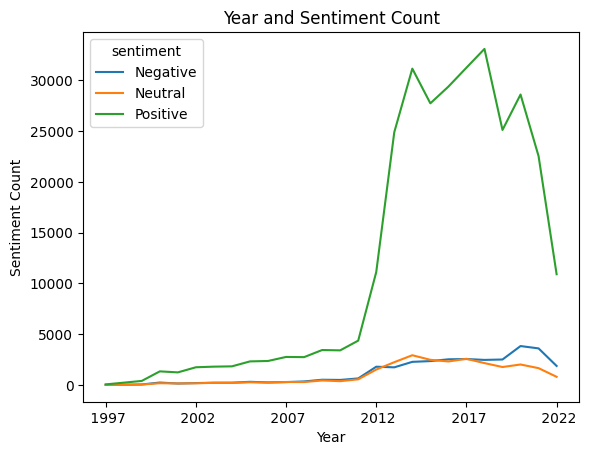

In [29]:
reviews.groupby(['year','sentiment'])['sentiment'].count().unstack().plot(legend=True)
plt.title('Year and Sentiment Count')
plt.xlabel('Year')
plt.ylabel('Sentiment Count')
plt.show()

**Insights:** <br>
**From the plot we can clearly see the rise in positive reviews from around 2011 to 2012. This could be due to Amazon.com maturing as a product/website and people adding more reviews during this time. Negative and neutral reviews are similar in number over time (in comparison to one another).**

## Creating few more features for text analysis
**Now, let's create polarity, review length and word count**

**Polarity:** **We use Textblob for for figuring out the rate of sentiment . It is between [-1,1] where -1 is negative and 1 is positive polarity.**

**Review length:** **length of the review which includes each letters and spaces**

**Word length:** **This measures how many words are there in review**

In [30]:
reviews['polarity'] = reviews['reviews'].map(lambda text: TextBlob(text).sentiment.polarity)
reviews['review_len'] = reviews['reviews'].astype(str).apply(len)
reviews['word_count'] = reviews['reviews'].apply(lambda x: len(str(x).split()))

In [31]:
reviews.head(1)

,product_name,rating,verified_purchase,reviews,sentiment,year,month,day,polarity,review_len,word_count
0,Ace Spades Faridah Abike Iyimide,4,True,engrossing page turner race class bullying gra...,Positive,2021,June,6,0.084393,3686,525


## Sentiment polarity distribution
**Let's look at our polarity distribution**

In [32]:
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)

In [33]:
reviews['polarity'].iplot(
    kind='hist',
    bins=50,
    xTitle='polarity',
    linecolor='black',
    yTitle='count',
    title='Sentiment Polarity Distribution'
)

**Insights:**
* **We have a lot of positive polarities compared to the negative polarities.**
* **This polarity distributions assures the number of positive reviews we had.**
* **We can say that this polarity is a normally distributed but not standard normal.**


## Review Rating Distribution
**We see below that we have an uneven distrubtion of ratings (with more positive than negative or neutral reviews).**

In [34]:
reviews['sentiment'].iplot(
    kind='hist',
    xTitle='sentiment',
    linecolor='black',
    yTitle='count',
    title='Review Rating Distribution'
)

## Review Text Length Distribution
**Let's check out the length of review text**

In [35]:
reviews['review_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='review length',
    linecolor='black',
    yTitle='count',
    title='Review Text Length Distribution'
)

**We have a right skewed distribution where most of the lengths falls between 0 and around 1000.**

## Review Text Word Count Distribution
**Let's check out the word count of review text**

In [36]:
reviews['word_count'].iplot(
    kind='hist',
    bins=100,
    xTitle='word count',
    linecolor='black',
    yTitle='count',
    title='Review Text Word Count Distribution'
)

**We have a right skewed distribution with most of the words falling between 0 to 200 or so in a a review.** 

In [37]:
#reviews.to_csv("Supervised_BClassification.csv",index=False)

<a id="section-four"></a>
# Extracting Features from Cleaned reviews
**Before we build the model for our sentiment analysis, it is required to convert the review texts into vector formation as computer cannot understand words and their sentiment. In this project, we are going to use TF-TDF method to convert the texts.**

In [38]:
reviews = reviews[['reviews', 'sentiment']]

In [39]:
# calling the label encoder function
label_encoder = preprocessing.LabelEncoder() 
  
# Encode labels in column 'sentiment'. 
reviews['sentiment'] = label_encoder.fit_transform(reviews['sentiment']) 
reviews['sentiment'].unique() 

y = reviews['sentiment']

In [40]:
reviews.tail()

,reviews,sentiment
384228,misleading book islam misleading book islamit ...,0
384229,ran united kingdom criticizes western nations ...,0
384230,good book easy read highly informative great y...,2
384231,excellent daughter needed book school absolute...,2
384232,added collection added daughters collection,2


## Finish Cleaning and Tokenizing the Amazon Banned Book Reviews Column

In [41]:
# Remove contractions
def contractions(s):
    s = re.sub(r"won’t", "will not",s)
    s = re.sub(r"would’t", "would not",s)
    s = re.sub(r"could’t", "could not",s)
    s = re.sub(r"\’d", " would",s)
    s = re.sub(r"can\’t", "can not",s)
    s = re.sub(r"n\’t", " not", s)
    s = re.sub(r"\’re", " are", s)
    s = re.sub(r"\’s", " is", s)
    s = re.sub(r"\’ll", " will", s)
    s = re.sub(r"\’t", " not", s)
    s = re.sub(r"\’ve", " have", s)
    s = re.sub(r"\’m", " am", s)
    return s

reviews['pre_process'] = reviews['reviews'].apply(lambda x:contractions(x))

In [42]:
## Remove non-alpha characters
reviews['pre_process'] = reviews['reviews'].apply(lambda x: " ".join([re.sub('[^A-Za-z]+','', x) for x in nltk.word_tokenize(x)]))

In [43]:
# Remove extra spaces
reviews['pre_process'] = reviews['reviews'].apply(lambda x: re.sub(' +', ' ', x))

In [44]:
# Remove stop words (nltk)
reviews['pre_process'] = reviews['reviews'].apply(lambda x: " ".join([x for x in x.split() if x not in stop]))

In [45]:
# Lemmatize words (nltk)
lemmatizer = WordNetLemmatizer()
reviews['pre_process'] = reviews['reviews'].apply(lambda x: " ".join([lemmatizer.lemmatize(w) for w in nltk.word_tokenize(x)]))

In [46]:
reviews = reviews[['pre_process', 'sentiment']]
reviews.tail(10)

,pre_process,sentiment
384222,another great book series love another great b...,2
384223,five star book informative provokes thought ma...,2
384224,inspiring malala amazing young girl didnt real...,2
384226,five star great book girl showing make big dif...,2
384227,love book book report book got,2
384228,misleading book islam misleading book islamit ...,0
384229,ran united kingdom criticizes western nation c...,0
384230,good book easy read highly informative great y...,2
384231,excellent daughter needed book school absolute...,2
384232,added collection added daughter collection,2


In [47]:
# Remove neutral columns (binary classification)
#reviews = reviews[reviews.rating != 3]

In [50]:
reviews.to_parquet("supervised_learning_data",index=False)

----